In [1]:
#test the code by reproducing a fit

#Set up the imports
import os
#---------------
import sys
vcModulePath='/home/rbussell/lib/'
sys.path.append(vcModulePath)

import importlib

import vc

from vc.load import *
from vc.parallel import *
from vc.fileutils import *
from vc.fit import *

importlib.reload(vc)


#------
#path stuff
#-------
dataDir='/home/rbussell/notebooks/vcproc/'

#----------------------------
#These are needed for running this specific code
#-------------------

import numpy as np


In [2]:
#------------------------------
#main
#-----------------------------

FIT_MASK=0

try:
    os.chdir(dataDir)
except OSError:
    print('Cannot change working directory to '+dataDir+' EXITING!');
    exit(0)

nSlices=14
nTIs=7
tiArr=np.arange(250,950,100)
idxTagStart=0
idxCtrStart=1

nX=64;
nY=64;
nReps=78;


id_dir='002_180308'
subDir='data/180308_setup3tw_cl'
M0=15;
alpha=1;
fsWide=(40,10)


#Read in a good data set
#Choose a good voxel
x=31;y=37;z=3; #original choice
#x=32;y=36;z=3;
#pick this patch for fitting
x1=23;x2=43;y1=30;y2=50;

In [3]:
print('loading the picore mat and the phicsmat')
picoreMat=np.zeros((nX,nY,nSlices,nReps,nTIs))
picoreMat=VC_loadPicoreData(subDir, id_dir,verbosity=0)
phiCSMat=VC_loadPhiCS(subDir,id_dir,verbosity=0)

#Get the phiCS for this slice
print('phiCSMat shape: ', np.shape(phiCSMat))
phiCS=phiCSMat[(z-1)::nSlices,:] #select a slice (incl. t and c, and TI)
phiCSTag=phiCS[idxTagStart::2,:] #now only take tags for this slice

#vectorize the inputs
phiCSVec=np.reshape(phiCSTag,(273,))
tiVec=np.reshape(np.tile(tiArr,(39,1)),(273,))

#----------------------
print("creating the tag and control vectors")
#deltaMat=picoreMat[:,:,:,idxCtrStart::2,:]-picoreMat[:,:,:,idxTagStart::2,:]
mTag=picoreMat[:,:,:,idxTagStart::2,:]
mCtr=picoreMat[:,:,:,idxCtrStart::2,:]
mCtrAve=np.mean(mCtr,3)
mTagMCtrAve=np.tile(np.reshape(mCtrAve,(nX,nY,nSlices,1,nTIs)),(1,1,1,int(nReps/2),1))-mTag
print('Input picore matrix shapes: \nmCtr: '+ str(np.shape(mCtr))+'\nmTag: '+ str(np.shape(mTag))+'\nmTagMCtrAve: '+ str((np.shape(mTagMCtrAve))))
verbosity=1
mTagMCtrAveVec=np.reshape(mTagMCtrAve,(nX,nY,nSlices,int(nTIs*nReps/2)))[x,y,z,:]
mTagVec=np.reshape(mTag,(nX,nY,nSlices,int(nTIs*nReps/2)))
mCtrVec=np.reshape(mCtr,(nX,nY,nSlices,int(nTIs*nReps/2)))
#deltaMSeqVec=mCtrVec[x,y,z,:]-mTagVec[x,y,z,:]
dataVec=mTagMCtrAveVec

loading the picore mat and the phicsmat
VC_loadPicoreData called
phiCSMat shape:  (1092, 7)
creating the tag and control vectors
Input picore matrix shapes: 
mCtr: (64, 64, 14, 39, 7)
mTag: (64, 64, 14, 39, 7)
mTagMCtrAve: (64, 64, 14, 39, 7)


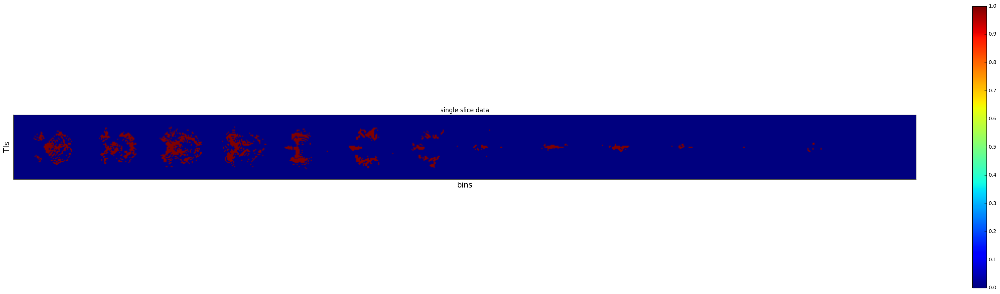

shape fitMask: (64, 64, 14)


In [4]:
#---------------------
#Create a mask for the data
#--------------------
id_dir='119_180612'
subDir='data/PupAlz_119'
M0=39;
pp=50;
alpha=1;
brainMaskFn=subDir+'/'+id_dir+'/reg/vti_mask.nii.gz'

if FIT_MASK==1:
    fitMask=makeFitMaskFile(subDir,id_dir,brainMaskFn,tiVec,nBins=8,nTIs=5,minMean=0.2,nSlices=14,nReps=78)
if FIT_MASK==0:
    fitMask=np.load(subDir+'/'+'fitMask.npy')
    fitMask=np.reshape(fitMask,(nX,nY,nSlices))
sliceDataMontage(fitMask[:,:,:,np.newaxis]);

print('shape fitMask: '+str(np.shape(fitMask)))
# set parameters that apply to all subjects
verbosity=0
dryRun=0

Available cores: 72
Cores needed:14
fitWithinMaskPar has: iSlice 0
fitWithinMaskPar has: mMethod 0
fitWithinMaskPar has: id_dir 119_180612
fitWithinMaskPar has: subDir data/PupAlz_119
fitWithinMaskPar has: nTIs 7
fitWithinMaskPar has: nTIsToFit 5
fitWithinMaskPar has: fitMask size (64, 64, 14)
fitWithinMaskPar has: M0 39
fitWithinMaskPar has: iSlice 1
fitWithinMaskPar has: alpha 1
fitWithinMaskPar has: id_dir 119_180612
fitWithinMaskPar has: verbosity 2
fitWithinMaskPar has: dryRun 0
fitWithinMaskPar has: subDir data/PupAlz_119
fitWithinMaskPar has: nBins 8
fitWithinMaskPar has: nTIs 7
fitWithinMaskPar has: mMethod 0
fitWithinMaskPar has: nTIsToFit 5
fitWithinMaskPar has: saveFn data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice0
fitWithinMaskPar has: fitMask size (64, 64, 14)
fitWithinMaskPar has: iSlice 2
fitWithinMaskPar has: M0 39
fitWithinMaskPar has: tiVec shape (273,)
fitWithinMaskPar has: alpha 1
VC_loadPicoreData called
fitWithinMaskPar has: verbosity 2
fitWithinMas

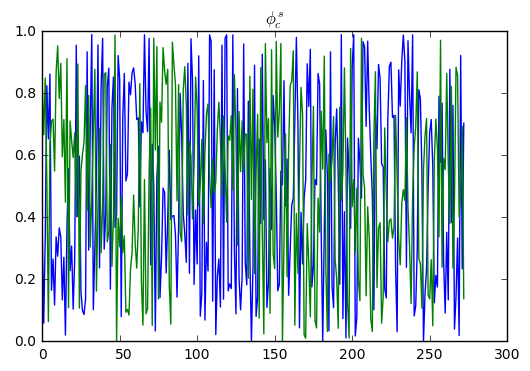

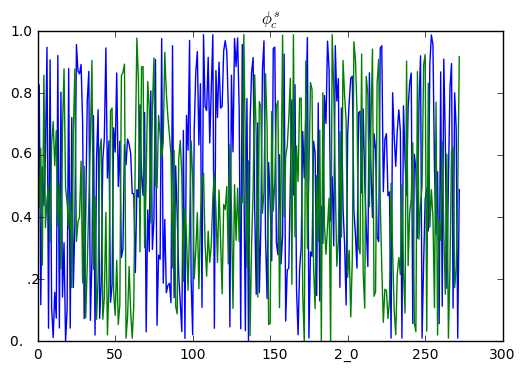

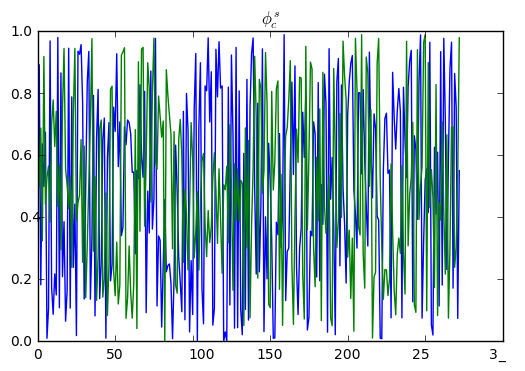

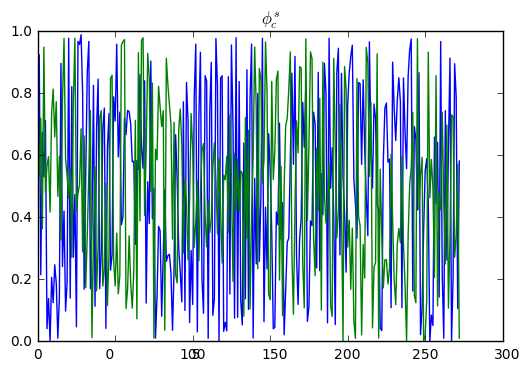

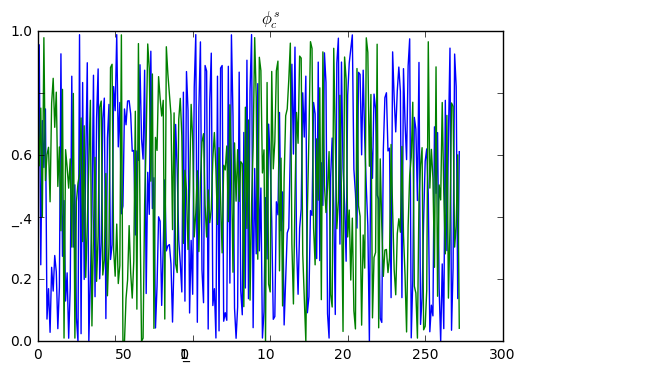

...

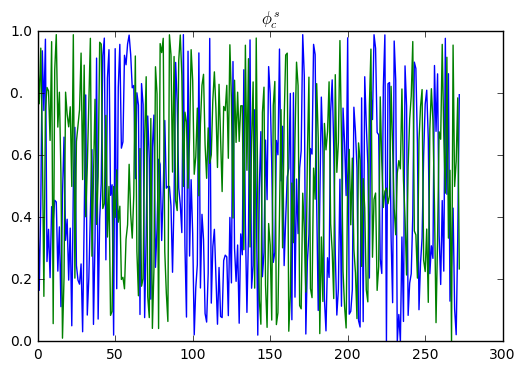

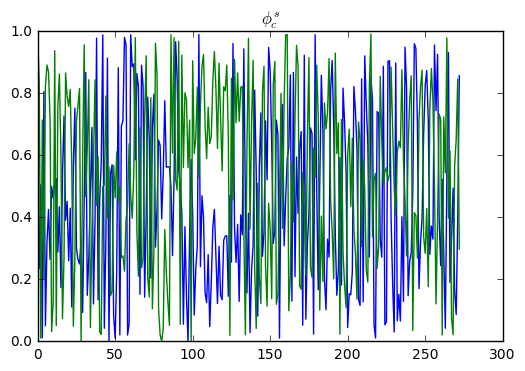

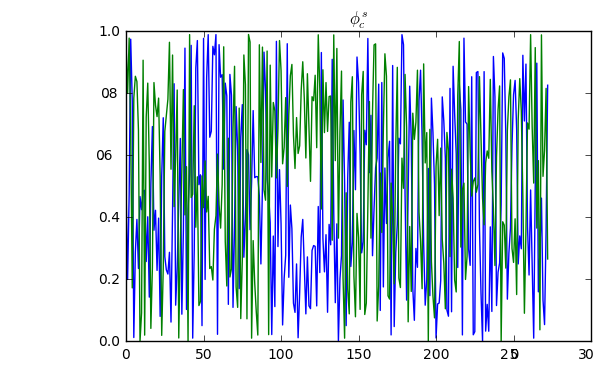

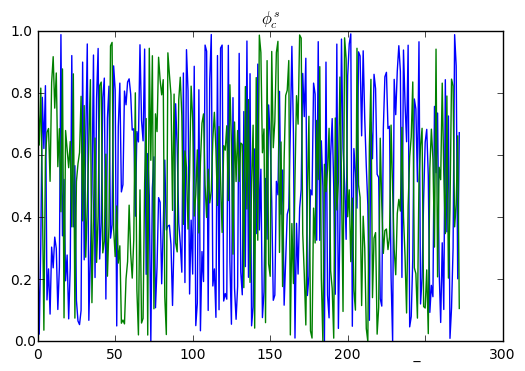

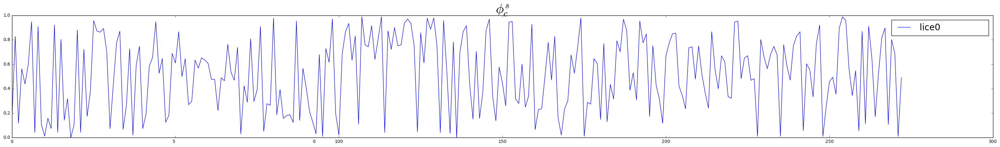

loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has zf:  1
loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has tiVec shape:  (273,)
loadDatToFit has nBins:  8
loadDatToFit has nTIs:  5


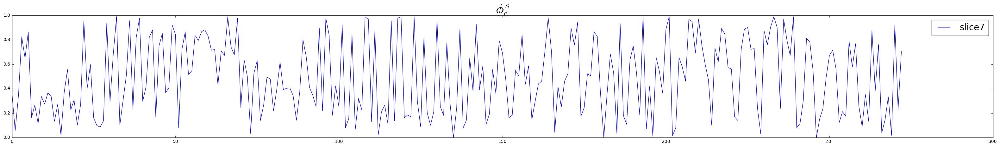

loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has zf:  8
loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has tiVec shape:  (273,)
loadDatToFit has nBins:  8
loadDatToFit has nTIs:  5


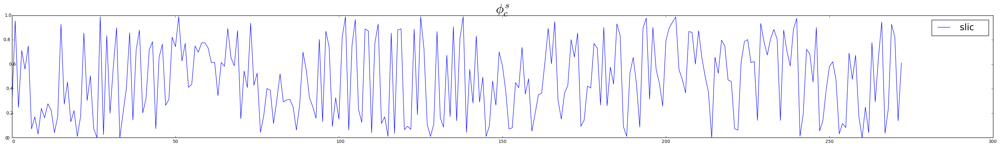

loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has zf:  5
loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has tiVec shape:  (273,)
loadDatToFit has nBins:  8
loadDatToFit has nTIs:  5


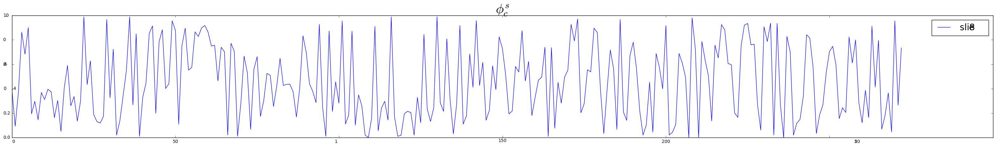

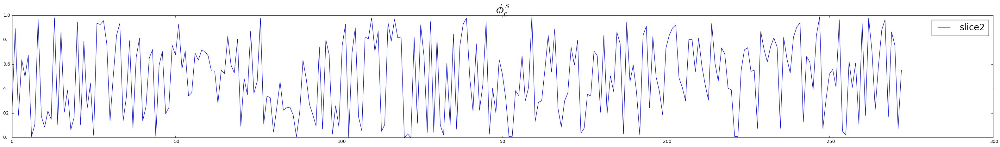

loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has zf:  9
loadDatToFit has zf:  3
loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has tiVec shape:  (273,)


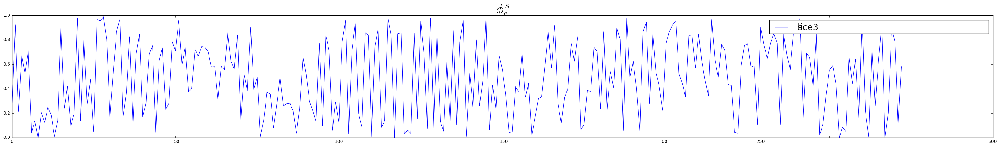

loadDatToFit has tiVec shape:  (273,)
loadDatToFit has nBins:  8
loadDatToFit has nBins:  8
loadDatToFit has nTIs:  5
loadDatToFit has nTIs:  5
loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has zf:  4
loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has tiVec shape:  (273,)
loadDatToFit has nBins:  8
loadDatToFit has nTIs:  5


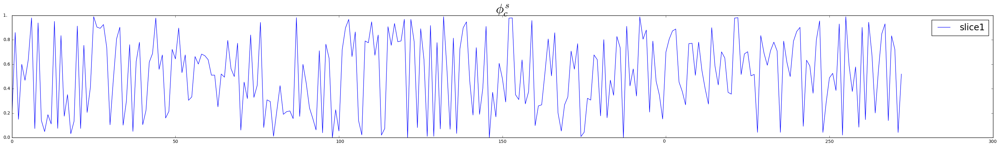

loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has zf:  2
loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has tiVec shape:  (273,)
loadDatToFit has nBins:  8
loadDatToFit has nTIs:  5


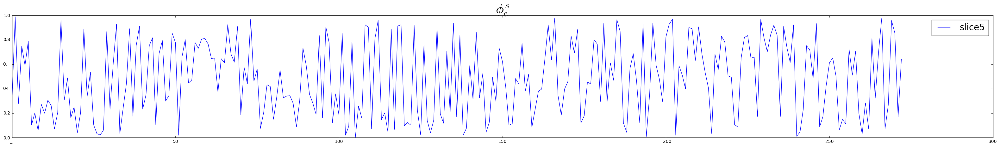

loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has zf:  6
loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has tiVec shape:  (273,)
loadDatToFit has nBins:  8
loadDatToFit has nTIs:  5


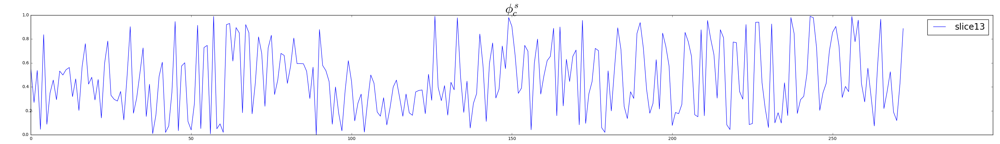

loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has zf:  14
loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has tiVec shape:  (273,)
loadDatToFit has nBins:  8
loadDatToFit has nTIs:  5


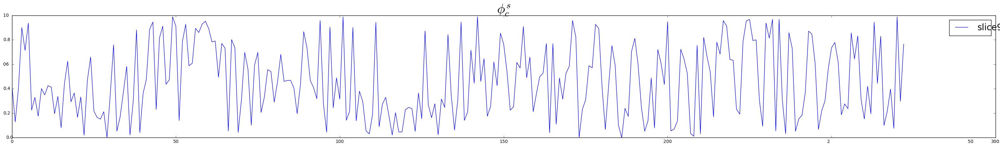

loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has zf:  10


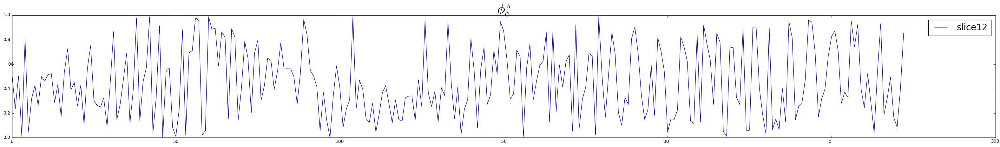

loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has tiVec shape:  (273,)
loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)


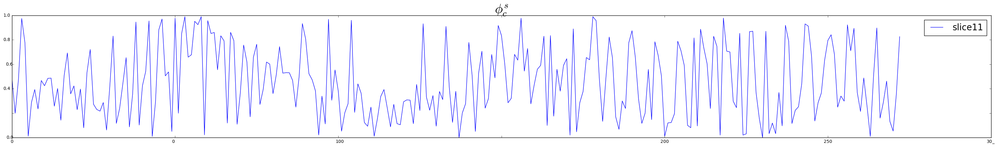

loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has nBins:  8
loadDatToFit has zf:  13
loadDatToFit has nTIs:  5
loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has tiVec shape:  (273,)
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has nBins:  8
loadDatToFit has zf:  12
loadDatToFit has nTIs:  5
loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has tiVec shape:  (273,)
loadDatToFit has nBins:  8
loadDatToFit has nTIs:  5


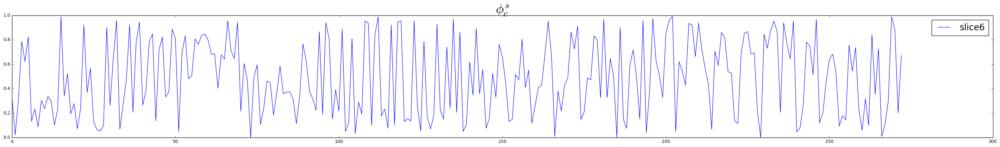

loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has zf:  7


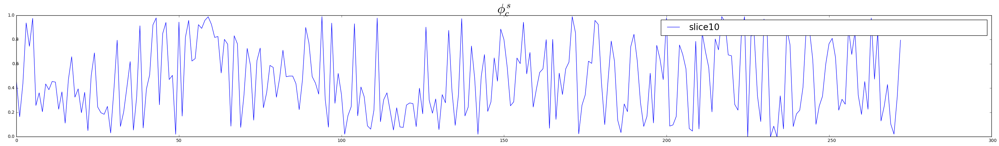

loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has tiVec shape:  (273,)
loadDatToFit has nBins:  8
loadDatToFit has picoreMat shape:  (64, 64, 14, 78, 7)
loadDatToFit has nTIs:  5
loadDatToFit has x1f,x2f,y1f,y2f:  1 64 1 64
loadDatToFit has zf:  11
loadDatToFit has phiCSVecCurSlice shape:  (273,)
loadDatToFit has tiVec shape:  (273,)
loadDatToFit has nBins:  8
loadDatToFit has nTIs:  5


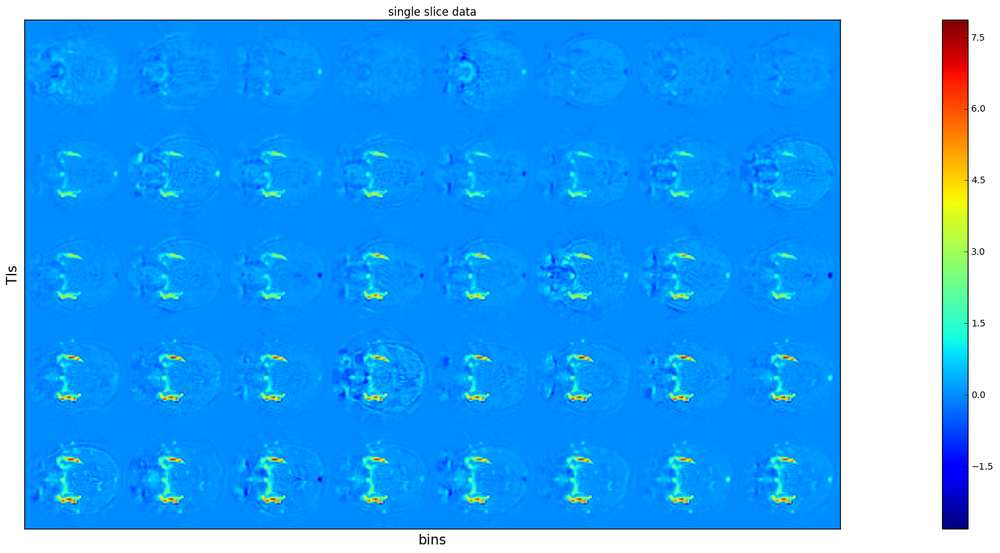

fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: before masking


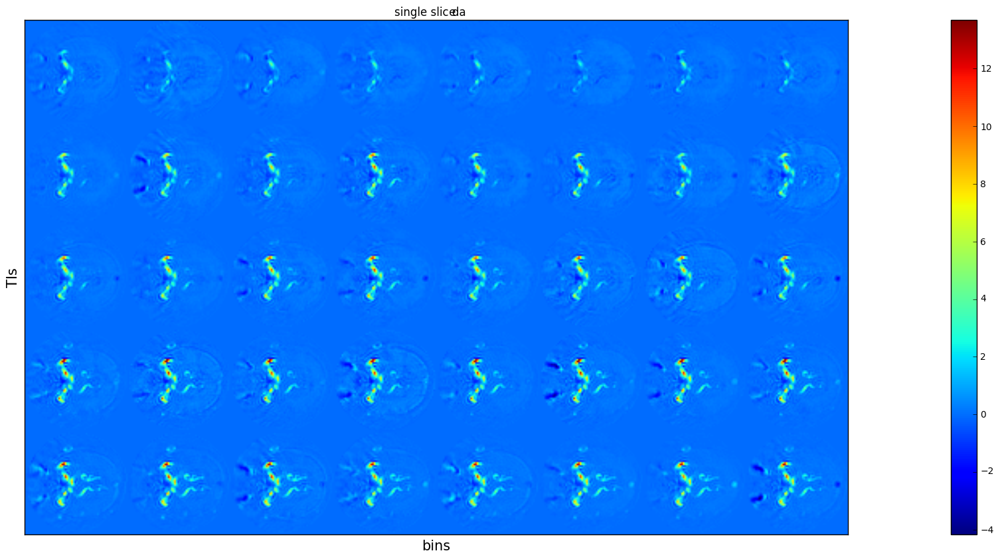

fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: before masking


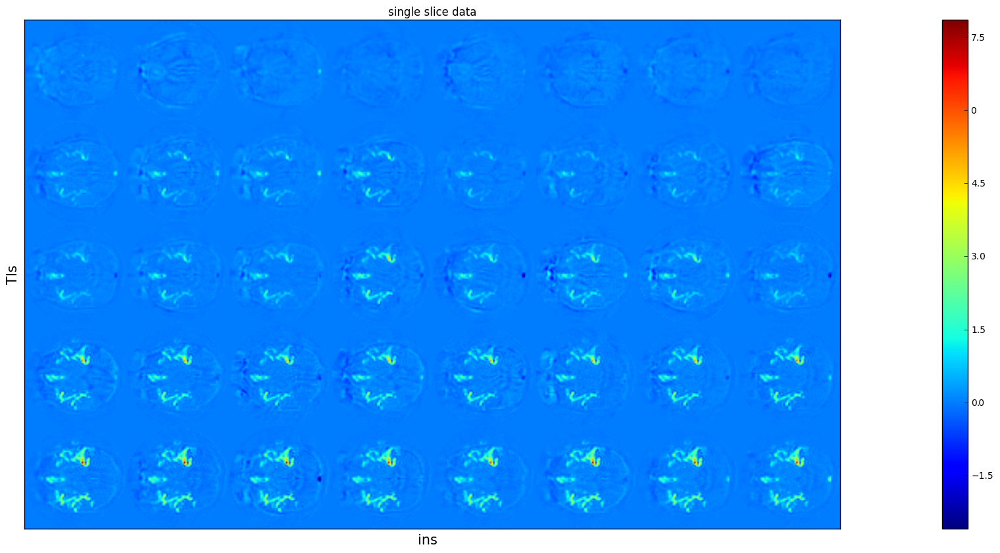

fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: before masking


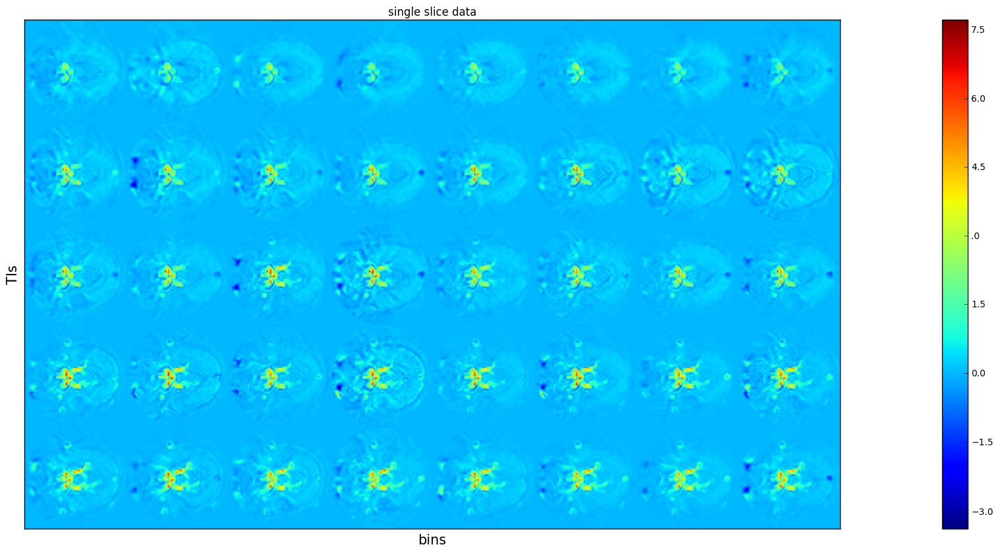

fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: before masking


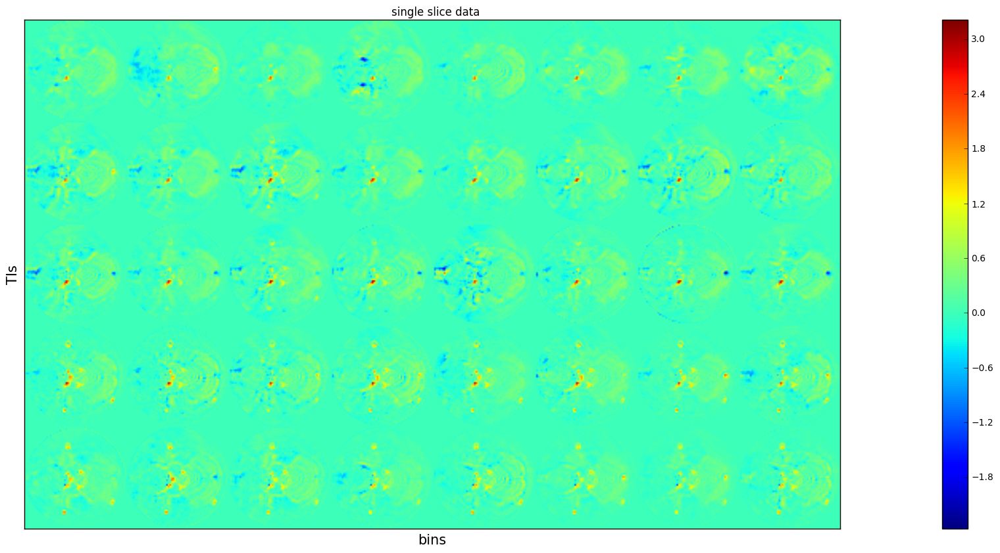

fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: before masking


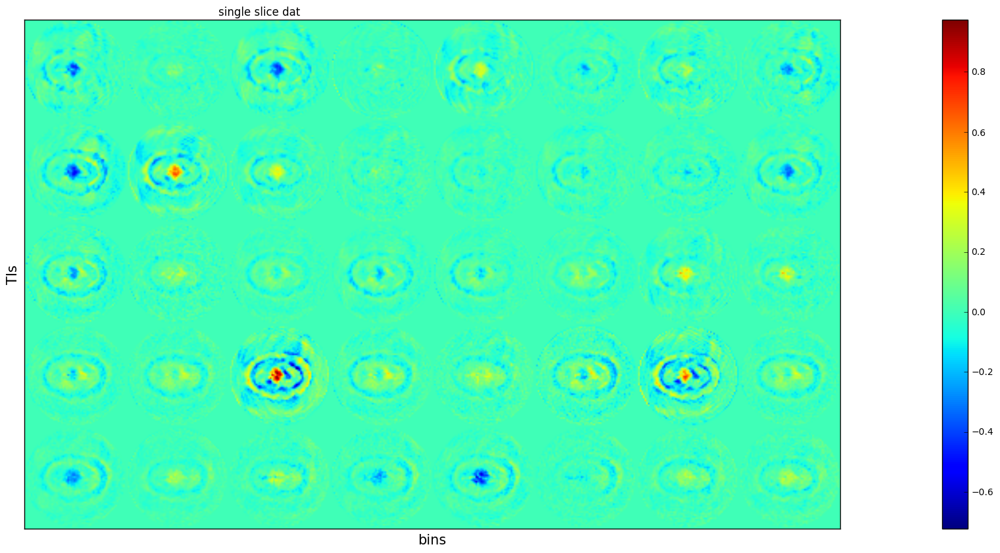

fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: before masking


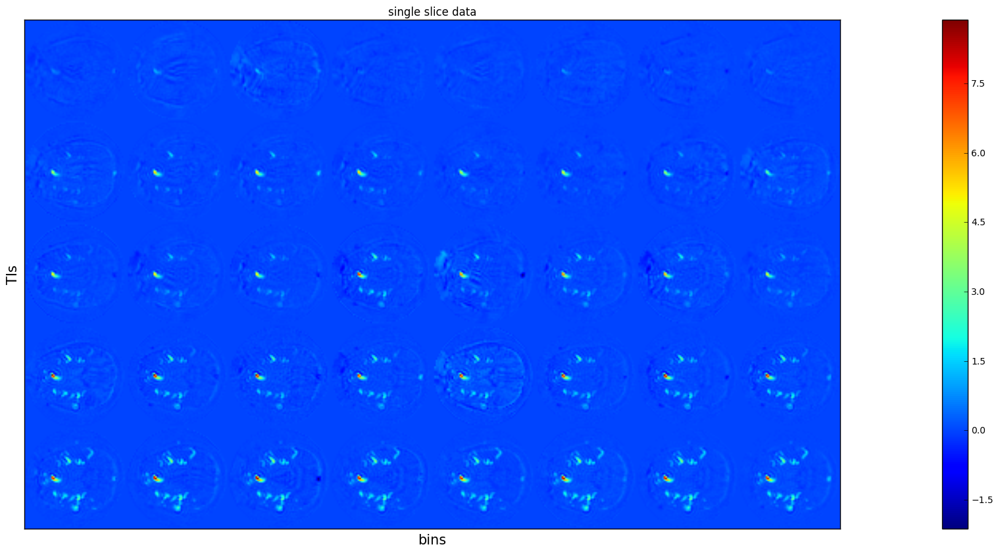

fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: before masking


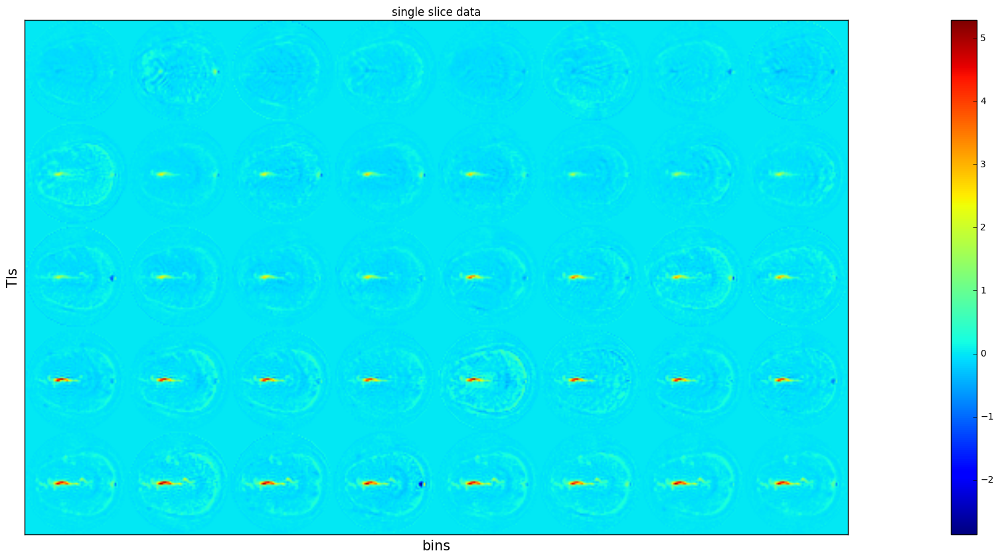

fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: before masking


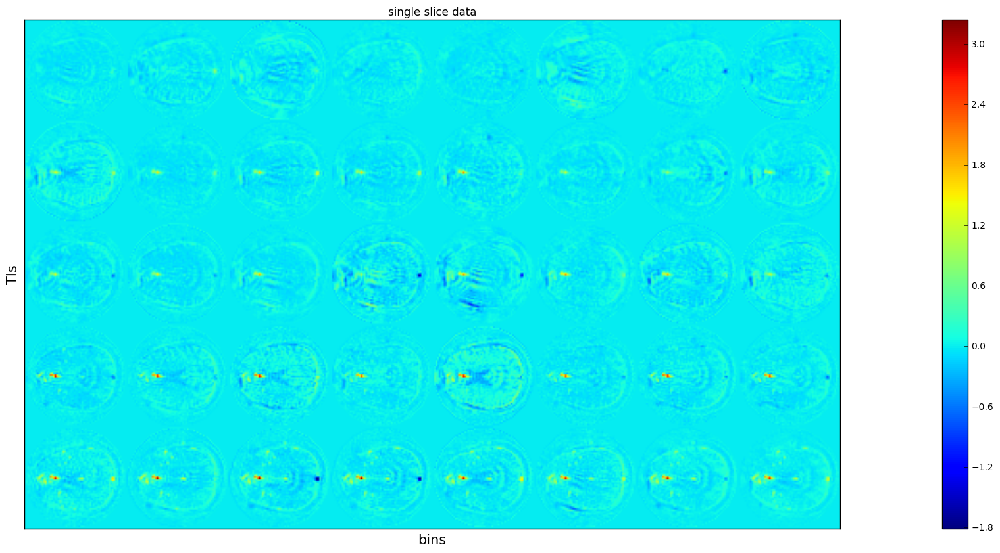

fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: before masking


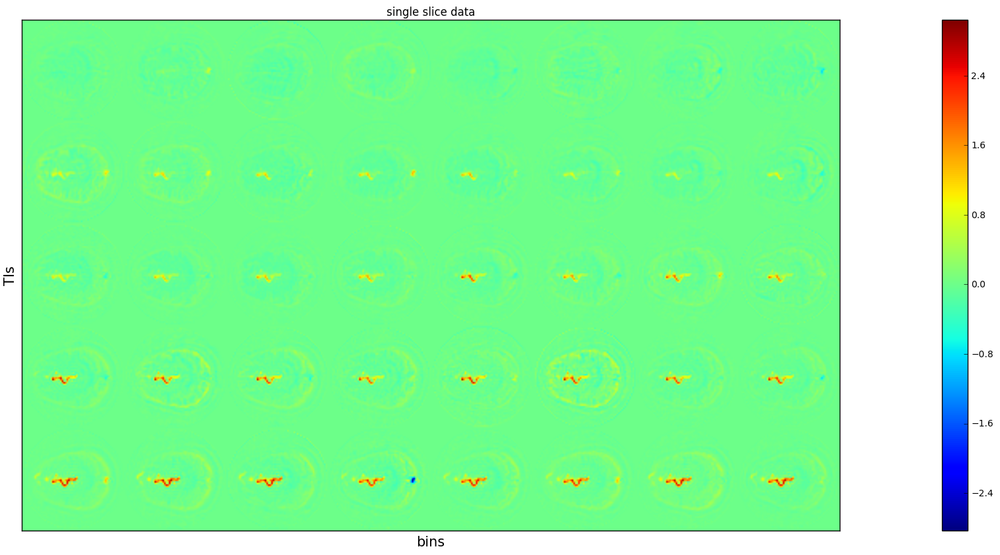

fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: before masking


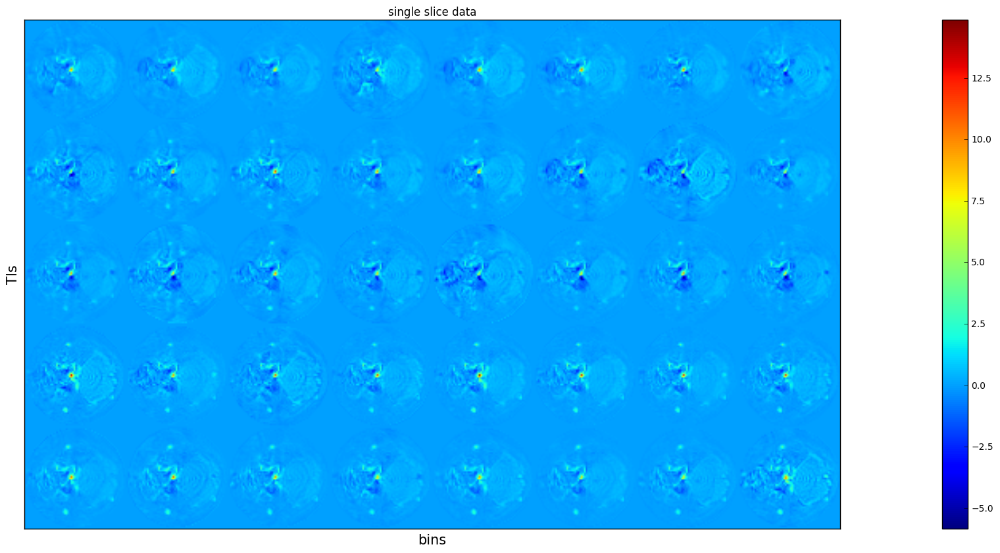

fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: before masking


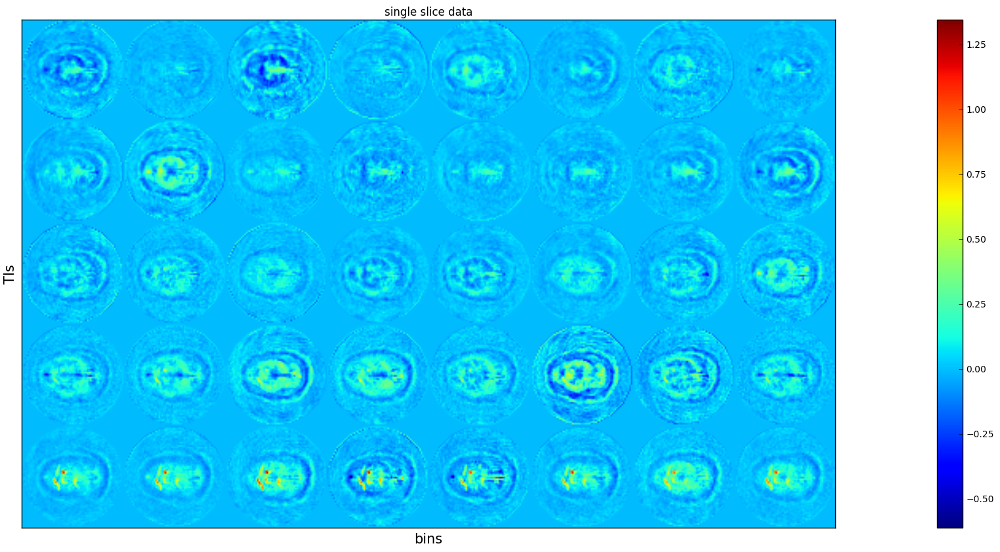

fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: before masking


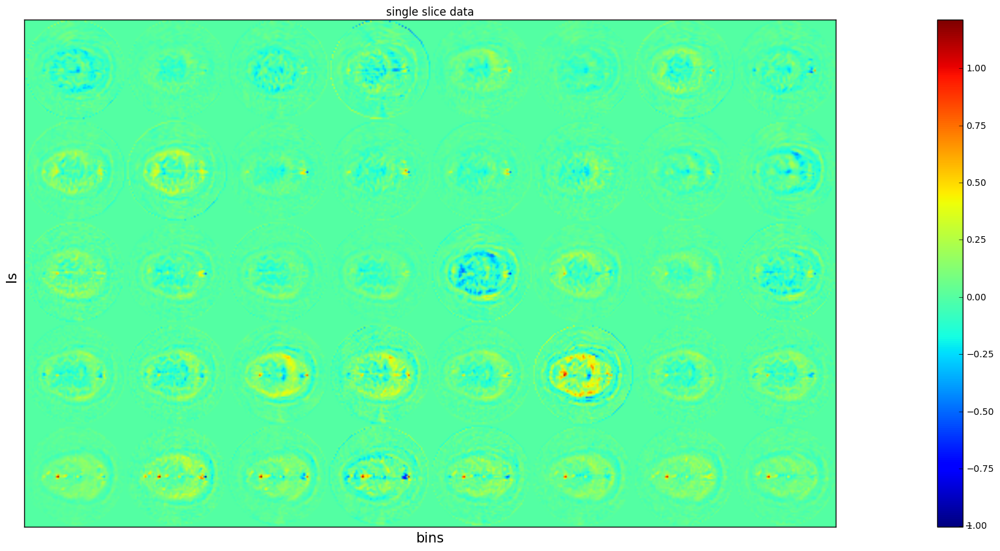

fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: before masking


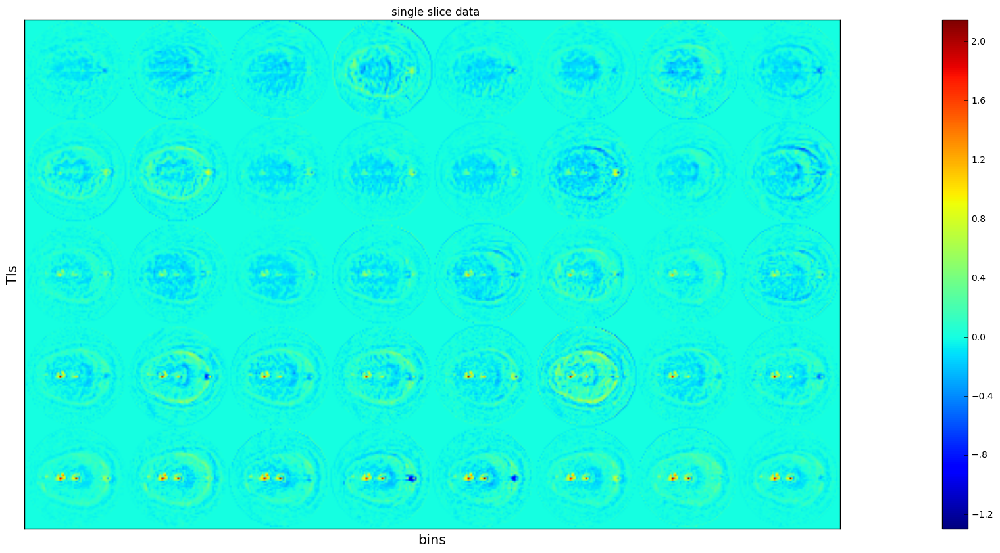

fitWithinMaskPar: shape fitMask (64, 64, 14)
fitWithinMaskPar: shape dataMat (64, 64, 8, 5)
fitWithinMaskPar: before masking


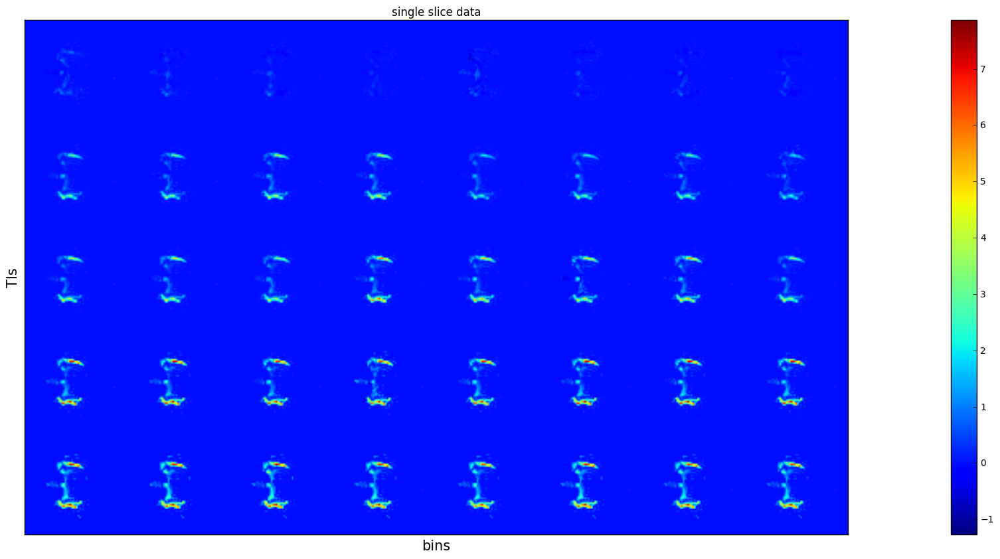

saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
dataMatMasked is shape (64, 64, 8, 5) sum 10036.073717959389
---fitWithinMaskPar_test---
 dataMatMasked is (64, 64, 8, 5)
 saveDir is: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
 tiVec is shape: (273,) has max min 850 250
 saveFn: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice4
 nTIs: 7
------------------------------
fitB called: dataMat has shape (64, 64, 8, 5) sum 10036.073717959389
fitB called: saving output to data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice4_partial
fitB has nTIsToFit= 5
fitB has saveDir=data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
fitB has tiVec=[250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550
 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250
 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650
 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350
 450 550 650 750 850 250 350 

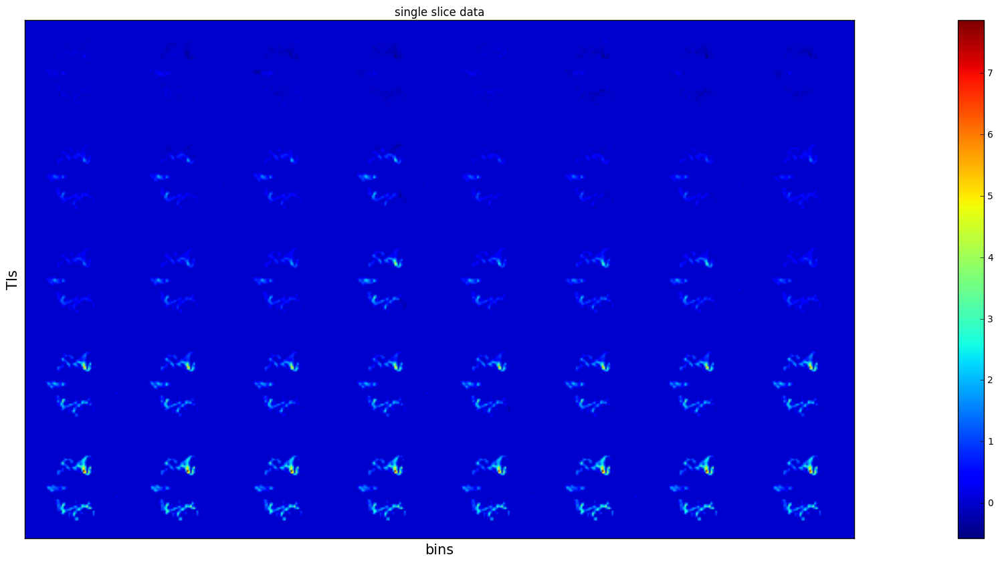

saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
dataMatMasked is shape (64, 64, 8, 5) sum 6943.629883391678
---fitWithinMaskPar_test---
 dataMatMasked is (64, 64, 8, 5)
 saveDir is: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
 tiVec is shape: (273,) has max min 850 250
 saveFn: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice5
 nTIs: 7
------------------------------
fitB called: dataMat has shape (64, 64, 8, 5) sum 6943.629883391678
fitB called: saving output to data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice5_partial
fitB has nTIsToFit= 5
fitB has saveDir=data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
fitB has tiVec=[250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550
 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250
 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650
 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350
 450 550 650 750 850 250 350 45

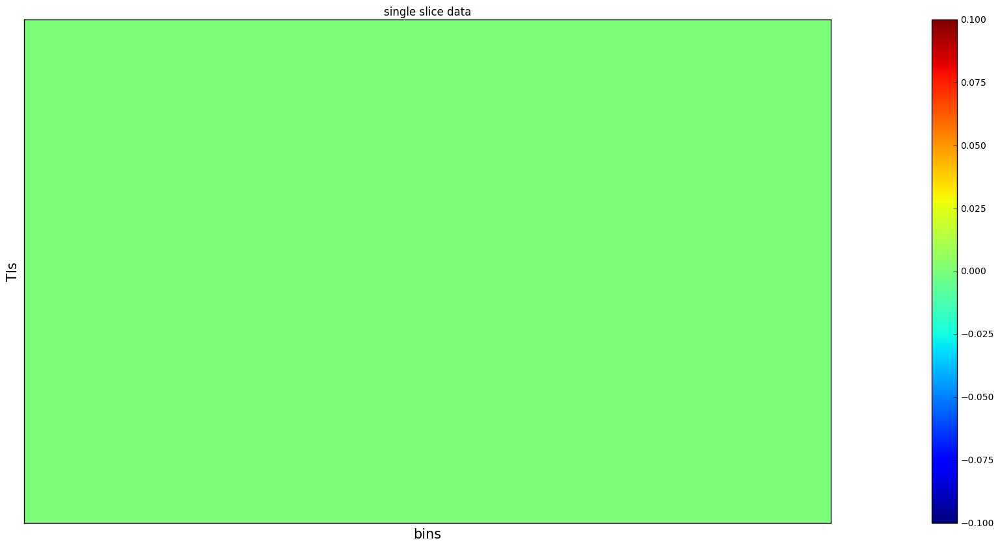

saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
dataMatMasked is shape (64, 64, 8, 5) sum 0.0
---fitWithinMaskPar_test---
 dataMatMasked is (64, 64, 8, 5)
 saveDir is: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
 tiVec is shape: (273,) has max min 850 250
 saveFn: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice13
 nTIs: 7
------------------------------
fitB called: dataMat has shape (64, 64, 8, 5) sum 0.0
fitB called: saving output to data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice13_partial
fitB has nTIsToFit= 5
fitB has saveDir=data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/


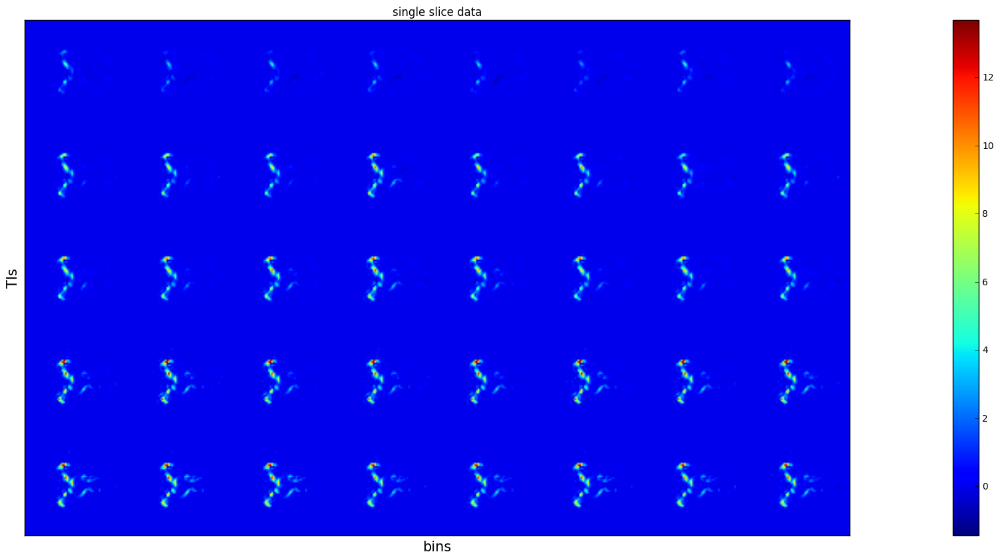

fitB has tiVec=[250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550
 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250
 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650
 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350
 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750
 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450
 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850
 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550
 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250
 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650
 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350
 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750
 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450
 550 650 750 850 250 350 450 550 650

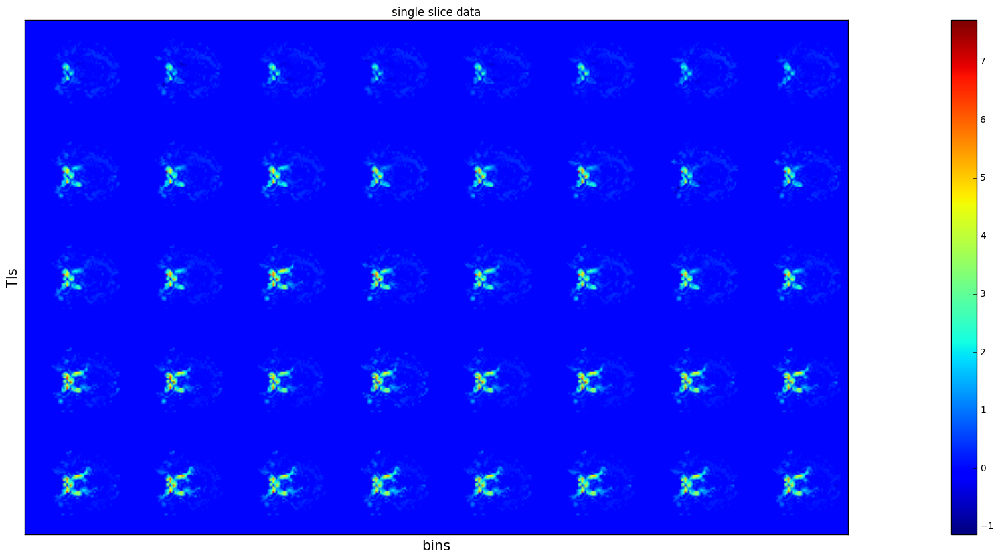

saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/

dataMatMasked is shape (64, 64, 8, 5) sum 14063.806611959804
---fitWithinMaskPar_test---
 dataMatMasked is (64, 64, 8, 5)
 saveDir is: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
 tiVec is shape: (273,) has max min 850 250
...........................................................................................................................................................fitting voxel 795 of 4096
 saveFn: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice2
 nTIs: 7
------------------------------
..............................................................................................................................................................................................................................................................................................................................................................................................................................

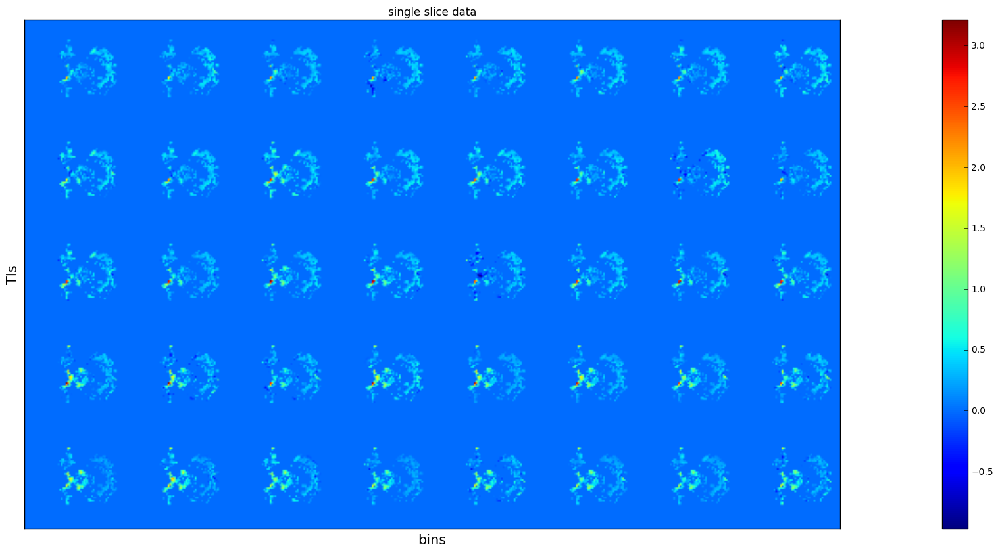

saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
dataMatMasked is shape (64, 64, 8, 5) sum 4901.415951759533
---fitWithinMaskPar_test---
 dataMatMasked is (64, 64, 8, 5)
 saveDir is: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
 tiVec is shape: (273,) has max min 850 250
 saveFn: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice1
 nTIs: 7
------------------------------
fitB called: dataMat has shape (64, 64, 8, 5) sum 4901.415951759533
fitB called: saving output to data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice1_partial


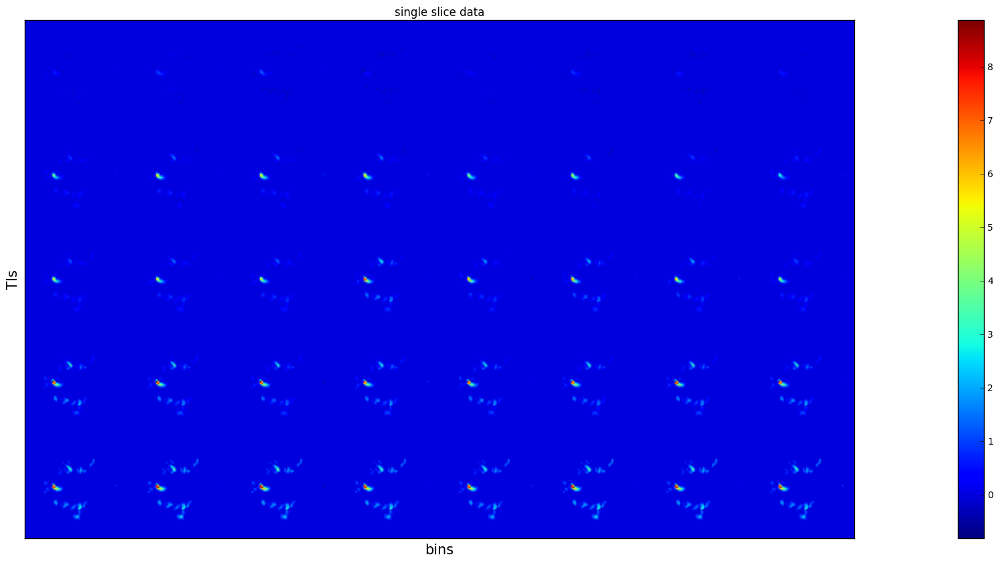

fitB has nTIsToFit= 5


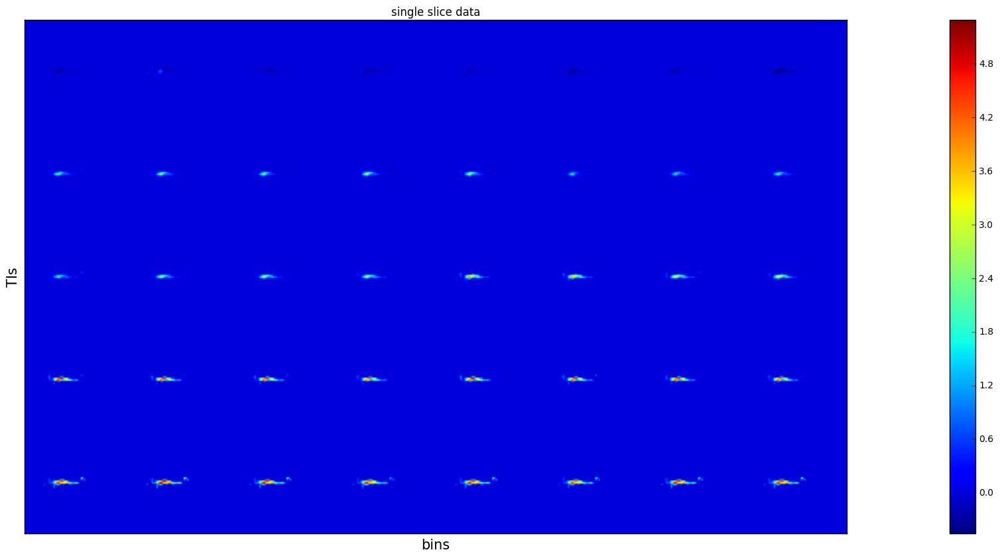

saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
fitB has saveDir=data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
dataMatMasked is shape (64, 64, 8, 5) sum 4318.532534975694
saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
---fitWithinMaskPar_test---
fitB has tiVec=[250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550
 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250
 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650
 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350
 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750
 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450
 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850
 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550
 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250
 350 450 550 650 750 850 250 350 450 550 650 750

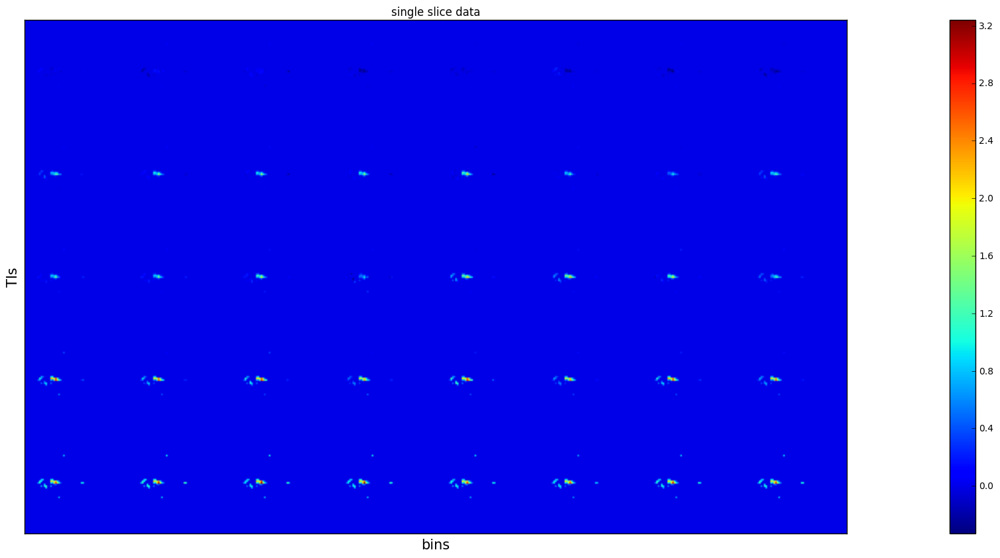

saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
dataMatMasked is shape (64, 64, 8, 5) sum 704.7388514741147
...........................................................................................................................................................................................................................fitting voxel 859 of 4096
---fitWithinMaskPar_test---
.............................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

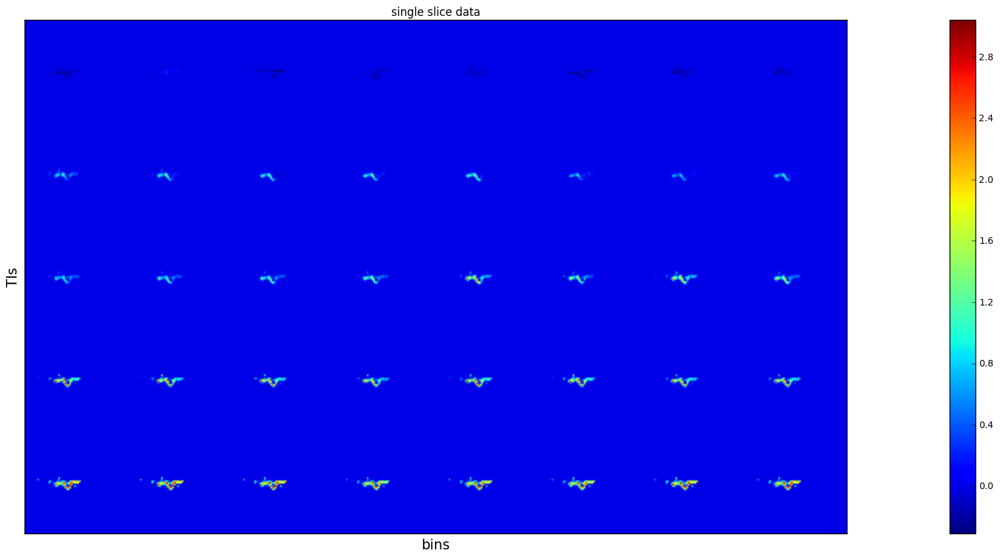

saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
dataMatMasked is shape (64, 64, 8, 5) sum 1474.4458579546367
---fitWithinMaskPar_test---
 dataMatMasked is (64, 64, 8, 5)
 saveDir is: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
 tiVec is shape: (273,) has max min 850 250
 saveFn: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice9
 nTIs: 7
------------------------------
fitB called: dataMat has shape (64, 64, 8, 5) sum 1474.4458579546367
fitB called: saving output to data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice9_partial
fitB has nTIsToFit= 5
fitB has saveDir=data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
fitB has tiVec=[250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550
 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250
 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650
 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350
 450 550 650 750 850 250 350 

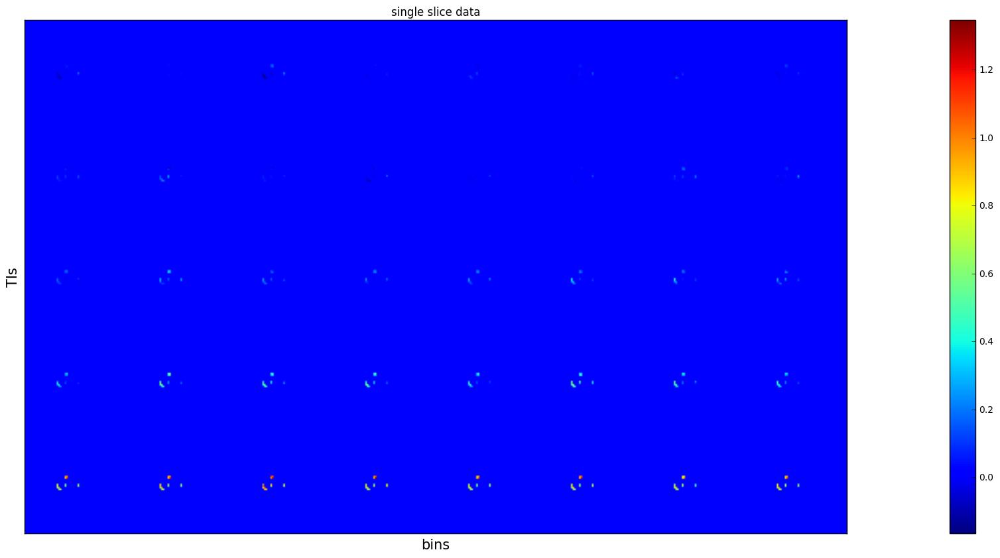

saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
dataMatMasked is shape (64, 64, 8, 5) sum 153.96138619116076
---fitWithinMaskPar_test---
 dataMatMasked is (64, 64, 8, 5)
 saveDir is: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
 tiVec is shape: (273,) has max min 850 250
 saveFn: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice12
 nTIs: 7
------------------------------
fitB called: dataMat has shape (64, 64, 8, 5) sum 153.96138619116076
fitB called: saving output to data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice12_partial
fitB has nTIsToFit= 5
fitB has saveDir=data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
fitB has tiVec=[250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550
 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250
 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650
 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350
 450 550 650 750 850 250 35

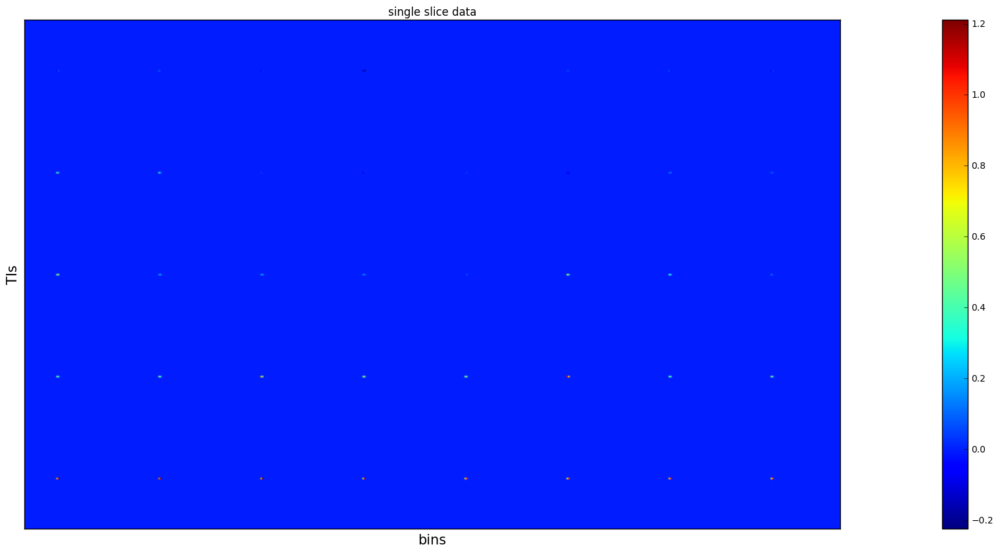

saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
dataMatMasked is shape (64, 64, 8, 5) sum 28.296412235825933

---fitWithinMaskPar_test---
 dataMatMasked is (64, 64, 8, 5)
 saveDir is: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
 tiVec is shape: (273,) has max min 850 250
 saveFn: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice11
 nTIs: 7
------------------------------
fitB called: dataMat has shape (64, 64, 8, 5) sum 28.296412235825933
fitB called: saving output to data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice11_partial
fitB has nTIsToFit= 5
fitB has saveDir=data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
fitB has tiVec=[250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550
 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250
 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650
 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350
 450 550 650 750 850 250 3

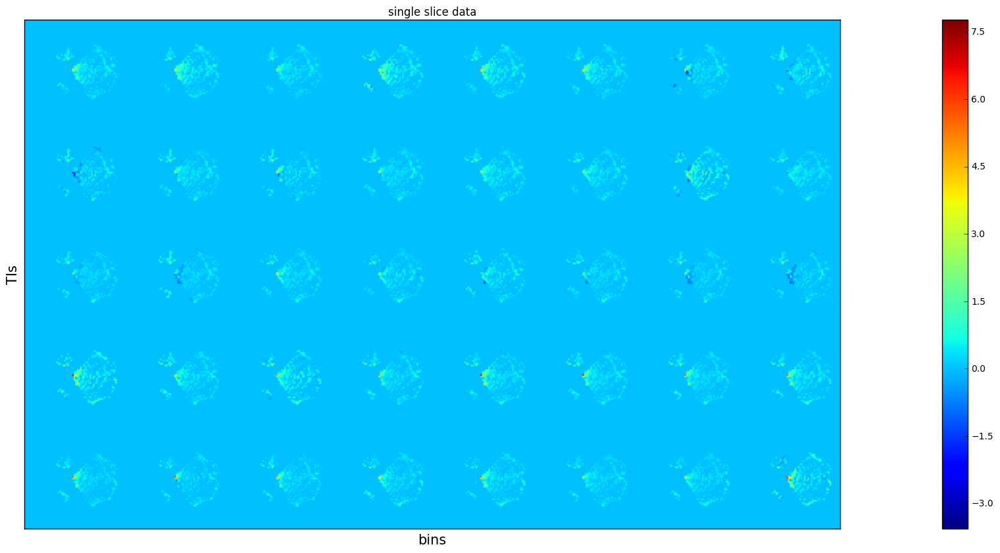

saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
dataMatMasked is shape (64, 64, 8, 5) sum 5316.492895707834
---fitWithinMaskPar_test---
 dataMatMasked is (64, 64, 8, 5)
 saveDir is: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
 tiVec is shape: (273,) has max min 850 250
 saveFn: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice0
 nTIs: 7
------------------------------
fitB called: dataMat has shape (64, 64, 8, 5) sum 5316.492895707834
fitB called: saving output to data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice0_partial
fitB has nTIsToFit= 5
fitB has saveDir=data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
fitB has tiVec=[250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550
 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250
 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650
 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350
 450 550 650 750 850 250 350 45

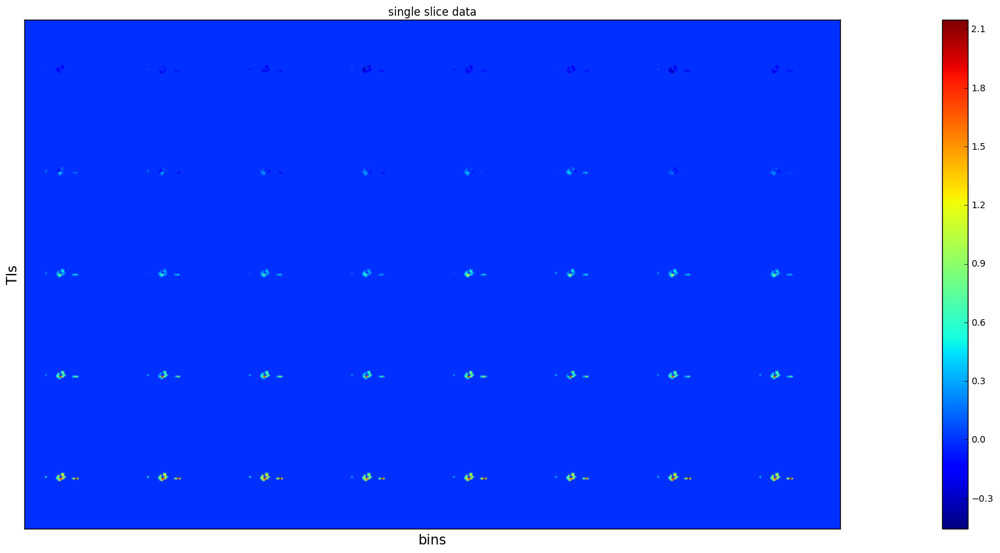

saveDir is data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
dataMatMasked is shape (64, 64, 8, 5) sum 334.46327679067014
---fitWithinMaskPar_test---
 dataMatMasked is (64, 64, 8, 5)
 saveDir is: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
 tiVec is shape: (273,) has max min 850 250
 saveFn: data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice10
 nTIs: 7
------------------------------
fitB called: dataMat has shape (64, 64, 8, 5) sum 334.46327679067014
fitB called: saving output to data/PupAlz_119/119_180612/vcontainertest/7TIs/m0//fitB_slice10_partial
fitB has nTIsToFit= 5
fitB has saveDir=data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/
fitB has tiVec=[250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550
 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250
 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350 450 550 650
 750 850 250 350 450 550 650 750 850 250 350 450 550 650 750 850 250 350
 450 550 650 750 850 250 35

In [5]:
#----------------------
#Run the fitting code on the ISMRM 2019 data
#---------------------
version='containertest'
DO_ISMRM2019_NTIS_COMPARISON=1
iSlice=0
saveFn=''
if DO_ISMRM2019_NTIS_COMPARISON:
    numProcessors=multiprocessing.cpu_count()
    #nWorkers=14*3
    nWorkers=14
    if nWorkers>numProcessors:
        nWorkers=numProcessors-1

    print('Available cores: '+str(numProcessors))
    print('Cores needed:' + str(nWorkers))

    pool = multiprocessing.Pool( nWorkers )

    #initialize the task list for each core
    tasks=[]

    pool = multiprocessing.Pool( nWorkers )

    #initialize the task list for each core
    tasks=[]
    
    #set up the 7 point fits
    nTIsToFit=7
    saveDir=makeSaveDir(subDir,id_dir,version,nTIsToFit,mMethod=0)
    makeTaskAllSlices(tasks,id_dir,subDir,saveDir,fitMask,tiVec,nX=64,nY=64,nSlices=14,nBins=8,nTIs=7,nReps=39,nTIsToFit=5,M0=M0,alpha=alpha,mMethod=0,dryRun=0,verbosity=2)
    #makeTaskAllSlices2p0test(tasks,id_dir,subDir,nTIsToFit,tiVec,fitMask,saveDir,M0=M0,alpha=alpha,verbosity=0,dryRun=dryRun,nBins=8,mMethod=0)

    #set up the 5 point fits
    #nTIsToFit=5
    #saveDir=makeSaveDir(subDir,id_dir,version,nTIsToFit,mMethod=0)
    #makeTaskAllSlices2p0test(tasks,id_dir,subDir,nTIsToFit,tiVec,fitMask,saveDir,M0=M0,alpha=alpha,verbosity=0,dryRun=dryRun,nBins=8,mMethod=0)

    #set up the 3 point fits
    #nTIsToFit=3
    #saveDir=makeSaveDir(subDir,id_dir,version,nTIsToFit,mMethod=0)
    #makeTaskAllSlices2p0test(tasks,id_dir,subDir,nTIsToFit,tiVec,fitMask,saveDir,M0=M0,alpha=alpha,verbosity=0,dryRun=dryRun,nBins=8,mMethod=0)

    print('tiVec is ' + str(tiVec));
    
    tStart = time.time()
    # Run tasks
    if 1:
        for t in tasks:
            #print('<<<<<<<<<will run this task>>>>>>>>>>')
            print(t)
            results=pool.apply_async( fitWithinMaskPar, t)
    #print(t)
    #results=pool.apply_async( fitWithinMaskPar2p0_test, t)
    
    #print(pool.map())
    pool.close()
    pool.join()

    
    tEnd = time.time()
    tElapsed=tEnd-tStart
    print('********Parallel fitting jobs required '+str(tElapsed)+'seconds. *********')

    #print(tasks)

In [ ]:
fitWithinMaskPar(1, '119_180612', 'data/PupAlz_119',fitMask,'data/PupAlz_119/119_180612/vcontainertest/7TIs/m0/', 64, 64, 14, 8, 39, 7, 5,tiVec, 39, 1, 0, 0, 2)

In [ ]:
M0

In [ ]:
saveDir=makeSaveDir(subDir,id_dir,version,nTIsToFit,mMethod=0)
fitWithinMaskPar2p0_test(iSlice,id_dir,subDir,fitMask,saveDir,nTIsToFit,tiVec,M0=M0,alpha=alpha,verbosity=0,dryRun=dryRun,nBins=8,mMethod=0)

    #nTIsToFit=5
    #for iSlice in np.arange(0,14,1):
    #    saveDir=makeSaveDir(subDir,id_dir,version,nTIsToFit,mMethod=0)
    #    fitWithinMaskPar2p0_test(iSlice,id_dir,subDir,fitMask,saveDir,nTIsToFit,tiVec,M0=M0,alpha=alpha,verbosity=0,dryRun=dryRun,nBins=8,mMethod=0)
    
    #fitWithinMaskPar2p0_test(0,id_dir,subDir,nTIsToFit,fitMask,saveDir,M0=M0,alpha=alpha,verbosity=0,dryRun=dryRun,nBins=8,mMethod=0)
    #fitWithinMaskPar2p0_test(0,id_dir,subDir,nTIsToFit,fitMask,saveDir,M0=M0,alpha=alpha,verbosity=0,dryRun=dryRun,nBins=8,mMethod=0)

In [ ]:
picoreMat=VC_loadPicoreData(subDir, id_dir,verbosity=0)
print(np.shape(picoreMat))

In [ ]:
id_dir